<a href="https://colab.research.google.com/github/fleuryc/oc_ingenieur-ia_P2-Participez-a-un-concours-sur-la-Smart-City/blob/main/main.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Concours Data is for Good : aidons Paris à devenir une smart-city !

## Contexte

Dans le cadre du programme "Végétalisons la ville" organisé par la ville de Paris, nous proposons ici une analyse exploratoire des données OpenData concernant les arbres gérés par la ville de Paris.

L'objectif est d'aider Paris à devenir une "Smart-City" en gérant ses arbres de la manière la plus responsable possible. C'est-à-dire en optimisant les trajets nécessaires pour entretenir ces arbres.


## Outils utilisés

Nous allons utiliser le langage Python, et présenter ici le code, les résultats et l'analyse sous forme de [Notebook Jupyter](https://jupyterlab.readthedocs.io/en/stable/getting_started/overview.html).

Nous allons aussi utiliser les bibliothèques usuelles d'exploration et analyse de données, afin d'améliorer la simplicité et la performance de notre code :
* [NumPy](https://numpy.org/doc/stable/user/quickstart.html) et [Pandas](https://pandas.pydata.org/docs/user_guide/index.html) : effectuer des calculs scientifiques (statistiques, algèbre, ...) et manipuler des séries et tableaux de données volumineuses et complexes
* [Matplotlib](https://matplotlib.org/stable/tutorials/introductory/usage.html), [Pyplot](https://matplotlib.org/stable/tutorials/introductory/pyplot.html), [Seaborne](https://seaborn.pydata.org/tutorial/function_overview.html) et [Plotly](https://plotly.com/python/getting-started/) : générer des graphiques lisibles, intéractifs et pertinents


In [2]:
# Import libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots


## Chargement des données et premier aperçu

Les données mises à disposition sont issues de  [opendata.paris.fr](https://opendata.paris.fr/explore/dataset/les-arbres/information/) et représentent "l’ensemble des arbres, ainsi que les arbres d’alignement, présents sur le territoire parisien et des cimetières extra-muros (hors de Paris)."



Nous allons dans un premier temps simplement charger les données en mémoire et observer quelques valeurs.

In [3]:
# load raw data into a Pandas DataFrame, separator is ";"
raw_data = pd.read_csv("https://s3-eu-west-1.amazonaws.com/static.oc-static.com/prod/courses/files/AI+Engineer/Project+2+Participez+%C3%A0+un+concours+sur+la+Smart+City/p2-arbres-fr.csv", sep=';')

# display first 5 rows
raw_data.head()


,id,type_emplacement,domanialite,arrondissement,complement_addresse,numero,lieu,id_emplacement,libelle_francais,genre,espece,variete,circonference_cm,hauteur_m,stade_developpement,remarquable,geo_point_2d_a,geo_point_2d_b
0,99874,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,19,Marronnier,Aesculus,hippocastanum,NaN,20,5,NaN,0.0,48.857620,2.320962
1,99875,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,20,If,Taxus,baccata,NaN,65,8,A,NaN,48.857656,2.321031
2,99876,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,21,If,Taxus,baccata,NaN,90,10,A,NaN,48.857705,2.321061
3,99877,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,22,Erable,Acer,negundo,NaN,60,8,A,NaN,48.857722,2.321006
4,99878,Arbre,Jardin,PARIS 17E ARRDT,NaN,NaN,PARC CLICHY-BATIGNOLLES-MARTIN LUTHER KING,000G0037,Arbre à miel,Tetradium,daniellii,NaN,38,0,NaN,NaN,48.890435,2.315289


Nous voyons que, pour chaque arbre listé, nous disposons des informations suivantes (la description des colonnes est disponible sur le site [OpenData](https://opendata.paris.fr/explore/dataset/les-arbres/information/)) :
- `id` : simple identifiant de l'arbre (entier, ex. : `99874`)
- `type_emplacement` : type de l'emplacement (texte, ex. : `"Arbre"`)
- `domanialite` : type de lieu auquel appartient l'arbre (texte, ex. : `"Jardin"`)
- `arrondissement` : arrondissement de Paris où est situé l'arbre (texte, ex. : `"PARIS 7E ARRDT"`)
- `complement_addresse` : complement d'adress (texte, pas d'exemple visible)
- `numero` : numéro de l'adress (texte, pas d'exemple visible)
- `lieu` : adresse de l'arbre (texte, ex. : `"MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E"`)
- `id_emplacement` : identifiant de l'emplacement (texte, ex. : `"19"`)
- `libelle_francais` : nom commun (vernaculaire) de l'espèce de l'arbre (texte, ex. : `"Marronnier"`)
- `genre` : genre de l'arbre (texte, ex. : `"Aesculus"`)
- `espece` : espèce de l'arbre (texte, ex. : `"hippocastanum"`)
- `variete` : variété de l'arbre (texte, pas d'exemple visible)
- `circonference_cm` : circonférence en centimètres de l'arbre (entier, ex. : `20`)
- `hauteur_m` : taille en mètres de l'arbre (entier, ex. : `5`)
- `stade_developpement` : stade de développement de l'arbre (texte, ex. : `"A"` pour "Adulte")
- `remarquable` : si l'arbre est "remarquable" ou non (booléen, ex. : `0` pour un arbre "non remarquable")
- `geo_point_2d_a` : latitude de la position de l'arbre (nombre à virgule, ex. : `48.857620`)
- `geo_point_2d_b` : longitude de la position de l'arbre (nombre à virgule, ex. : `2.320962`)

Nous voyons déjà que parmis les quelques premières données :
- un certain certain nombre de valeurs ne sont pas fournies (`NaN` = "Not a Number" = donnée non disponible)
- nous pouvons classer les variables selon leur type :
    - quantitatives
        - discrètes : `id`, `circonference_cm`, `hauteur_m`
        - continues : `geo_point_2d_a`, `geo_point_2d_b`
    - qualitatives
        - nominales : `type_emplacement`, `domanialite`, `arrondissement`, `complement_addresse`, `numero`, `lieu`, `id_emplacement`, `libelle_francais`, `genre`, `espece`, `variete`
        - ordinales : `stade_developpement`, `remarquable`
- on peut aussi les classer en trois grandes catégories, d'après leur sens :
    - métadonnées internes au système : `id`, `id_emplacement`, `type_emplacement`
    - données de localisation : `arrondissement`, `complement_addresse`, `numero`, `lieu`, `geo_point_2d_a`, `geo_point_2d_b`
    - données de description : 
        - taille : `circonference_cm`, `hauteur_m` et `stade_developpement`
        - type : `libelle_francais`, `genre`, `espece` et `variete`
        - autre : `remarquable`


Nous allons observer plus précisément les types de valeurs et les valeurs vides :

In [4]:
# Display data types and empty values
raw_data.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200137 entries, 0 to 200136
Data columns (total 18 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   id                   200137 non-null  int64  
 1   type_emplacement     200137 non-null  object 
 2   domanialite          200136 non-null  object 
 3   arrondissement       200137 non-null  object 
 4   complement_addresse  30902 non-null   object 
 5   numero               0 non-null       float64
 6   lieu                 200137 non-null  object 
 7   id_emplacement       200137 non-null  object 
 8   libelle_francais     198640 non-null  object 
 9   genre                200121 non-null  object 
 10  espece               198385 non-null  object 
 11  variete              36777 non-null   object 
 12  circonference_cm     200137 non-null  int64  
 13  hauteur_m            200137 non-null  int64  
 14  stade_developpement  132932 non-null  object 
 15  remarquable      

Nous voyons alors que :
- la colonne `numero` n'est jamais renseignée (`Non-Null count = 0`)
    - ce critère n'apporte donc pas d'information
- les colonnes `complement_addresse` (`Non-Null count = 30902`) et `variete` (`Non-Null count = 36777`) sont très peu renseignées (> 80% de valeurs non définies)
    - les informations apportées par ces colonnes seront donc très difficilement exploitables en l'état
- les colonnes `stade_developpement` (`Non-Null count = 132932`) et `remarquable` (`Non-Null count = 137039`) sont partiellement renseignées (> 30% de valeurs non définies)
    - les informations apportées par ces colonnes seront donc pas facilement exploitables en l'état
- les colonnes `libelle_francais` (`Non-Null count = 198640`) et `espece` (`Non-Null count = 198385`) sont pas toujours renseignées (> 0,5% de valeurs non définies)
    - les informations apportées par ces colonnes sont assez fiables, mais il faudra faire attention aux cas non renseignés


## Première analyse statistique

Nous allons maintenant chercher à comprendre comment sont réparties les valeurs pour chaque caractéristique de nos arbres.



Une simple description statistique de chaque colonne nous donne les informations suivantes :
- pour chaque donnée numérique (`id`, `circonference_cm`, `hauteur_m`, `remarquable`, `geo_point_2d_a` et `geo_point_2d_b`), nous obtenons :
    - le nombre de valeurs non vides (`count`)
    - la moyenne (`mean`)
    - l'écart-type (`std`)
    - les valeurs minimale (`min`) et maximale (`max`)
    - les 25, 50 (médiane) et 75 centiles (`25%`, `50%` et `75%`)

- our chaque donnée textuelle (`type_emplacement`, `domanialite`, `arrondissement`, `complement_addresse`, `lieu`, `id_emplacement`, `libelle_francais`, `genre`, `espece`, `variete` et `stade_developpement`), nous obtenons :
    - le nombre de valeurs non vides (`count`)
    - le nombre de valeurs différentes (`unique`)
    - la valeur la plus représentée (`top`)
    - la fréquence de la valeur la plus représentée (`freq`)


In [5]:
# Display statistical summary of each column
raw_data.describe(include="all")


,id,type_emplacement,domanialite,arrondissement,complement_addresse,numero,lieu,id_emplacement,libelle_francais,genre,espece,variete,circonference_cm,hauteur_m,stade_developpement,remarquable,geo_point_2d_a,geo_point_2d_b
count,2.001370e+05,200137,200136,200137,30902,0.0,200137,200137,198640,200121,198385,36777,200137.000000,200137.000000,132932,137039.000000,200137.000000,200137.000000
unique,NaN,1,9,25,3795,NaN,6921,69040,192,175,539,436,NaN,NaN,4,NaN,NaN,NaN
top,NaN,Arbre,Alignement,PARIS 15E ARRDT,SN°,NaN,PARC FLORAL DE PARIS / ROUTE DE LA PYRAMIDE,101001,Platane,Platanus,x hispanica,Baumannii',NaN,NaN,A,NaN,NaN,NaN
freq,NaN,200137,104949,17151,557,NaN,2995,1324,42508,42591,36409,4538,NaN,NaN,64438,NaN,NaN,NaN
mean,3.872027e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.380479,13.110509,NaN,0.001343,48.854491,2.348208
std,5.456032e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,673.190213,1971.217387,NaN,0.036618,0.030234,0.051220
min,9.987400e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,NaN,0.000000,48.742290,2.210241
25%,1.559270e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,30.000000,5.000000,NaN,0.000000,48.835021,2.307530
50%,2.210780e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,70.000000,8.000000,NaN,0.000000,48.854162,2.351095
75%,2.741020e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,115.000000,12.000000,NaN,0.000000,48.876447,2.386838


Observons maintenant la distribution empirique de chaque variable, de manière non visuelle dans un premier temps, afin de voir quels types de graphes seront ensuite le plus adaptés :

In [6]:
for col in raw_data.columns:
    """ display value frequencies per column
    """
    print(f'\n \
================================================\n \
>    { col }\n \
------------------------------------------------')

    counts = raw_data[col].value_counts()
    freq = raw_data[col].value_counts(normalize=True)
    display(pd.DataFrame({'count': counts, 'freq': freq}))
    


 >    id
 ------------------------------------------------


,count,freq
264191,1,0.000005
132330,1,0.000005
337166,1,0.000005
347395,1,0.000005
2008362,1,0.000005
...,...,...
119535,1,0.000005
121582,1,0.000005
115437,1,0.000005
117484,1,0.000005



 >    type_emplacement
 ------------------------------------------------


,count,freq
Arbre,200137,1.0



 >    domanialite
 ------------------------------------------------


,count,freq
Alignement,104949,0.524388
Jardin,46262,0.231153
CIMETIERE,31926,0.159522
DASCO,6422,0.032088
PERIPHERIQUE,5327,0.026617
DJS,3900,0.019487
DFPE,1325,0.006620
DAC,21,0.000105
DASES,4,0.000020



 >    arrondissement
 ------------------------------------------------


,count,freq
PARIS 15E ARRDT,17151,0.085696
PARIS 13E ARRDT,16712,0.083503
PARIS 16E ARRDT,16403,0.081959
PARIS 20E ARRDT,15340,0.076647
PARIS 19E ARRDT,13709,0.068498
PARIS 12E ARRDT,12600,0.062957
SEINE-SAINT-DENIS,11570,0.057810
BOIS DE VINCENNES,11510,0.057511
PARIS 14E ARRDT,11399,0.056956
PARIS 17E ARRDT,10762,0.053773



 >    complement_addresse
 ------------------------------------------------


,count,freq
SN°,557,0.018025
1,552,0.017863
2,547,0.017701
3,498,0.016115
4,464,0.015015
...,...,...
F 106,1,0.000032
4V,1,0.000032
lampadaire 9210,1,0.000032
station velib 17/105,1,0.000032



 >    numero
 ------------------------------------------------


,count,freq



 >    lieu
 ------------------------------------------------


,count,freq
PARC FLORAL DE PARIS / ROUTE DE LA PYRAMIDE,2995,0.014965
PARC DES BUTTES CHAUMONT,2331,0.011647
PARC ANDRE CITROEN,2095,0.010468
PARC OMNISPORT SUZANNE LENGLEN / 7 BOULEVARD DES FRERES VOISIN,1478,0.007385
INSEP / AVENUE DU TREMBLAY,1293,0.006461
...,...,...
RUE DAVY,1,0.000005
CIMETIERE DE PANTIN / DIV 66,1,0.000005
CRECHE (8) FONTAINE A MULARD,1,0.000005
PIERRE NICOLE (38-40),1,0.000005



 >    id_emplacement
 ------------------------------------------------


,count,freq
101001,1324,0.006615
101002,1241,0.006201
101003,1128,0.005636
202001,1032,0.005156
101004,1020,0.005097
...,...,...
A15000044008,1,0.000005
1048,1,0.000005
L0740032,1,0.000005
F0280009,1,0.000005



 >    libelle_francais
 ------------------------------------------------


,count,freq
Platane,42508,0.213995
Marronnier,25207,0.126898
Tilleul,21305,0.107254
Erable,18389,0.092575
Sophora,11797,0.059389
...,...,...
Ormeau épineux,1,0.000005
Ostryer,1,0.000005
Stewartia,1,0.000005
Laurier des Açores,1,0.000005



 >    genre
 ------------------------------------------------


,count,freq
Platanus,42591,0.212826
Aesculus,25341,0.126628
Tilia,21550,0.107685
Acer,18471,0.092299
Sophora,11830,0.059114
...,...,...
Heptacodium,1,0.000005
Caragana,1,0.000005
Ziziphus,1,0.000005
Genista,1,0.000005



 >    espece
 ------------------------------------------------


,count,freq
x hispanica,36409,0.183527
hippocastanum,20039,0.101011
japonica,11822,0.059591
n. sp.,9063,0.045684
tomentosa,8962,0.045175
...,...,...
amurensis,1,0.000005
occidentalis var. reticulata,1,0.000005
x chinensis,1,0.000005
x durettii,1,0.000005



 >    variete
 ------------------------------------------------


,count,freq
Baumannii',4538,0.123392
Briotii',2827,0.076869
Euchlora',2756,0.074938
Chanticleer',2595,0.070560
Fastigiata',2483,0.067515
...,...,...
Otto Luyken',1,0.000027
Clanbrassiliana',1,0.000027
Beurré Clairgeau',1,0.000027
Conspicua',1,0.000027



 >    circonference_cm
 ------------------------------------------------


,count,freq
0,25867,0.129246
20,9711,0.048522
70,6780,0.033877
60,6369,0.031823
80,6206,0.031009
...,...,...
453,1,0.000005
965,1,0.000005
710,1,0.000005
9155,1,0.000005



 >    hauteur_m
 ------------------------------------------------


,count,freq
0,39219,0.195961
10,28632,0.143062
5,26345,0.131635
15,17228,0.086081
8,13628,0.068093
...,...,...
1216,1,0.000005
218,1,0.000005
154,1,0.000005
91,1,0.000005



 >    stade_developpement
 ------------------------------------------------


,count,freq
A,64438,0.484744
JA,35444,0.266633
J,26937,0.202637
M,6113,0.045986



 >    remarquable
 ------------------------------------------------


,count,freq
0.0,136855,0.998657
1.0,184,0.001343



 >    geo_point_2d_a
 ------------------------------------------------


,count,freq
48.837168,2,0.000010
48.833919,2,0.000010
48.887740,2,0.000010
48.829328,2,0.000010
48.879931,2,0.000010
...,...,...
48.887492,1,0.000005
48.901033,1,0.000005
48.877057,1,0.000005
48.873387,1,0.000005



 >    geo_point_2d_b
 ------------------------------------------------


,count,freq
2.439268,2,0.000010
2.311181,2,0.000010
2.336083,2,0.000010
2.299317,2,0.000010
2.387348,2,0.000010
...,...,...
2.454810,1,0.000005
2.314236,1,0.000005
2.330632,1,0.000005
2.387441,1,0.000005



Nous voyons alors que :
- chaque arbre possède un `id` unique
    - cette variable n'apporte donc aucun information
- il n'y a qu'une seule valeur possible pour la variable `type_emplacement` : `"Arbre"`
    - ce critère n'apporte donc pas d'information
- les valeurs respectives de `complement_addresse` et `id_emplacement` sont très disparates dans leur format (pas de valeurs très représentatives) et ne sont pas humainement parlantes
- la colonne `lieu` peut être découpée avec le séparateur `" / "` afin de regrouper par exemple tous les lieux commenant par `"CIMETIERE DE PANTIN"`
- les données de `circonference_cm` et `hauteur_m` ont des valeurs aberrantes dont il faudra tenir compte :
    - `minimum = 0` , ce qui semble impossible
    - `circonference_cm` : `maximum = 250255` et `hauteur_m` : `maximum = 881818` , ce qui semble impossible


## Un peu de nettoyage

Nous allons :
- supprimer les colonnes inutiles : `type_emplacement` et `numero`
- renommer les valeurs de `stade_developpement` pour des valeurs plus explicites
- découper la valeur de `lieu` avec le séparateur `" / "`
- créer de nouvelles colonnes `top_XXX` où les valeurs les moins fréquentes seront remplacées par la valeur `"Other"` pour les colonnes `lieu`, `lieu_1`, `libelle_francais`, `genre`, `espece` et `variete`

In [7]:

# drop useless columns
clean_data = raw_data.drop(columns=['type_emplacement','numero'])

# replace `stade_developpement` values
clean_data.stade_developpement.replace({
    'J' :'Jeune', 
    'JA':'Jeune Adulte', 
    'A' :'Adulte', 
    'M' :'Mature',
}, inplace=True)

# extract the first part of column `lieu`
clean_data['lieu_1'] = clean_data["lieu"].str.split("/", expand=True)[0].str.strip()


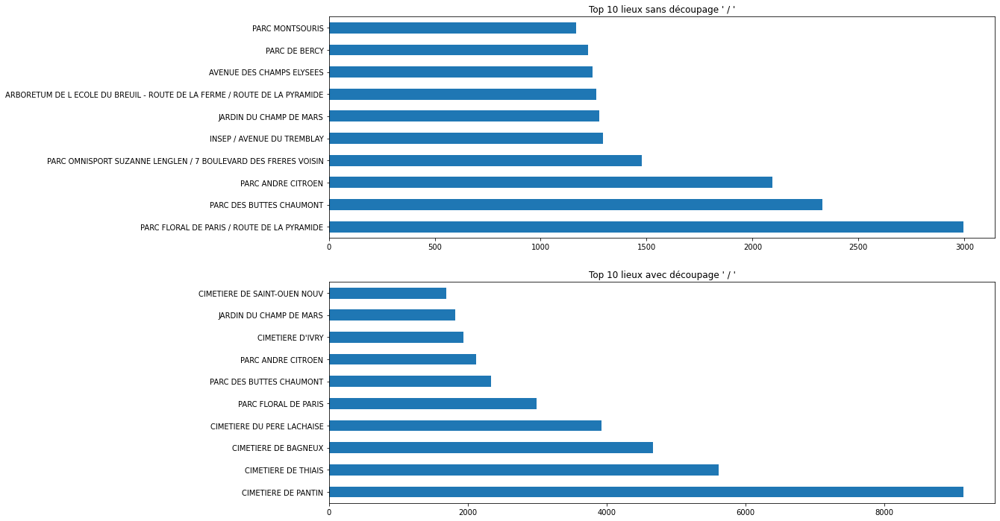

In [41]:
# Display values of lieu and lieu_1
fig, (ax1, ax2) = plt.subplots(2, 1, 
    figsize=(16,12),
)

clean_data['lieu'].value_counts().head(10).plot(
    kind='barh', 
    ax=ax1,
    title="Top 10 lieux sans découpage ' / '",
)

clean_data['lieu_1'].value_counts().head(10).plot(
    kind='barh', 
    ax=ax2,
    title="Top 10 lieux avec découpage ' / '",
)

plt.show() # Affiche le graphique


In [9]:
# Let's keep only the top values and merge the rest into "Other"
for col in ['lieu', 'lieu_1', 'libelle_francais', 'genre', 'espece', 'variete']:
    freq = clean_data[col].value_counts()
    clean_data['top_'+col] = clean_data[col].where(
        clean_data[col].isna() | clean_data[col].isin(freq.index[:20]), 
        other='Other', 
    )


In [10]:
# Let's see if categories are well organised
fig = px.parallel_categories(clean_data,
    dimensions=['arrondissement', 'top_lieu_1', 'top_lieu'],
    title="Classification des lieux",
    width=1000,
    height=800,
)
fig.show()

fig = px.parallel_categories(clean_data,
    dimensions=['top_libelle_francais', 'top_genre', 'top_espece', 'top_variete'],
    title="Classification des variétés d'arbres",
    width=1000,
    height=800,
)
fig.show()


## Améliorons la gestion des arbres

Nous allons ici nous appuyer sur des analyses statistiques et des graphiques afin de voir comment il serait possible d'améliorer le service de gestion des arbres de Paris.



### Quels arbres faut-il mesurer à nouveau ?

Pour la suite de l'analyse, nous allons éliminer les données abberrantes ("outliers). Pour celà, nous allons utiliser le critère [IQR](https://en.wikipedia.org/wiki/Interquartile_range#Outliers). Nous allons considérer toutes les données de taille trop éloignées de la norme, ainsi que les valeurs égales à `0` comme des données aberrantes.

Nous allons dans un premier temps afficher une cartographie de ces arbres, car ceux-ci devront être mesurés à nouveau afin d'améliorer la fiabilité de la gestion de nos arbres.
Nous allons ensuite considérer ces données comme nulles (`NaN`).


In [11]:
# Let's work on a copy of our clean data.
data = clean_data.copy()

# First, let's consider zeros as NaN
data['circonference_cm'].where(data['circonference_cm'] > 0, inplace=True)
data['hauteur_m'].where(data['hauteur_m'] > 0, inplace=True)

# Let's compute the InterQuartile range in order to identify outliers
quartiles = data[['circonference_cm', 'hauteur_m']].quantile([0.25, 0.75])
iqr = quartiles.loc[0.75]-quartiles.loc[0.25]
limits = pd.DataFrame({
    'circonference_cm': [
        max(0, quartiles.loc[0.25,'circonference_cm'] - 1.5 * iqr['circonference_cm']), # min
        quartiles.loc[0.75,'circonference_cm'] + 1.5 * iqr['circonference_cm'], # max
    ],
    'hauteur_m': [
        max(0, quartiles.loc[0.25,'hauteur_m'] - 1.5 * iqr['hauteur_m']), # min
        quartiles.loc[0.75,'hauteur_m'] + 1.5 * iqr['hauteur_m'], # max
    ]
}, index=['min', 'max'])

display(quartiles, limits)


,circonference_cm,hauteur_m
0.25,45.0,6.0
0.75,123.0,14.0


,circonference_cm,hauteur_m
min,0.0,0.0
max,240.0,26.0



Nous voyons qu'un arbre "normal" aura :
- une circonférence comprise entre 0 et 240 cm
- une hauteur comprise entre 0 et 26 m

Nous allons maintenant visualiser où sont situé ces arbres "anormaux" (outliers), afin de planifier les tournées de mesure de ces arbres.


In [12]:

# outliers are the trees outside the IQR range
outliers = clean_data[
    ( clean_data['circonference_cm'] <= limits.loc['min','circonference_cm'] )
    | ( clean_data['circonference_cm'] >= limits.loc['max','circonference_cm'] )
    | ( clean_data['hauteur_m'] <= limits.loc['min','hauteur_m'] )
    | ( clean_data['hauteur_m'] >= limits.loc['max','hauteur_m'] )
]


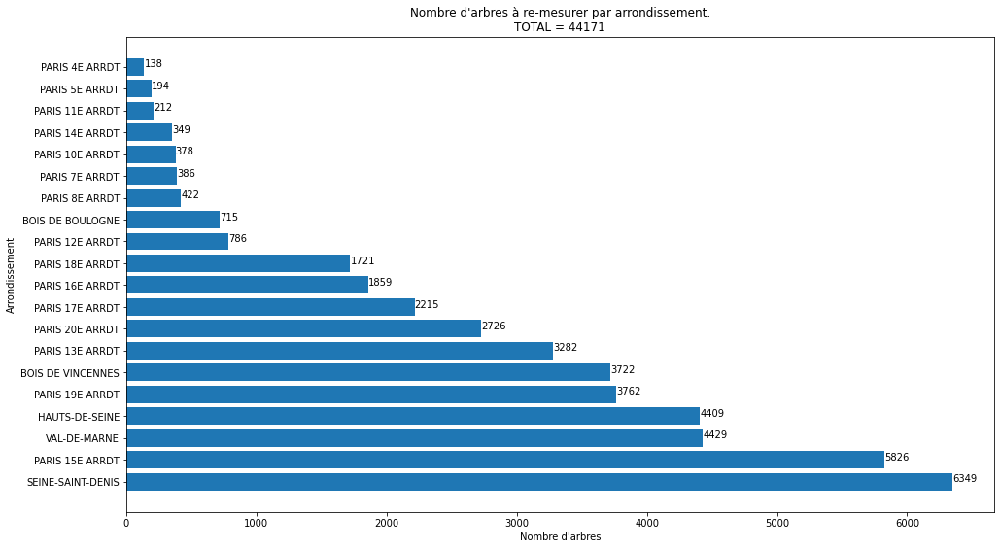

In [13]:

# Count trees per burrough
count_per_arrondissement = outliers['arrondissement'].value_counts().head(20)

# resize figure
plt.figure(figsize=(16,9))

# plot horizontal bar chart
plt.barh(
    y=count_per_arrondissement.index,
    width=count_per_arrondissement.values,
)

# add labels for the value of each bar
for index, value in enumerate(count_per_arrondissement):
    plt.text(y=index , x=value+1 , s=f"{value}")

# add title and labels
plt.xlabel("Nombre d'arbres")
plt.ylabel("Arrondissement")
plt.title(f"Nombre d'arbres à re-mesurer par arrondissement.\nTOTAL = { len(outliers) }")

# display the figure
plt.show()


In [14]:

# Display the outliers on a map
fig = px.density_mapbox(outliers, 
    lat='geo_point_2d_a', lon='geo_point_2d_b',
    hover_data=['circonference_cm', 'hauteur_m', 'arrondissement', 'lieu', 'domanialite'],
    radius=2,
    zoom=10,
    mapbox_style="open-street-map",
    title="Localisation des arbres à re-mesurer",
    width=1000,
    height=800,
)
fig.show()



Nous voyons ici la carte des 44171 arbres qu'il faudrait mesurer à nouveau.

En attendant que ces arbres soient mesurés à nouveau, nous allons maintenant les ignorer dans nos prochaines analyses : passer à `NaN` les valeurs "hors norme".


In [15]:

# set to NaN data that are outside the range
for col in ['circonference_cm', 'hauteur_m']:
    clean_data[col] = clean_data[col].where(( 
        ( limits.loc['min', col] < clean_data[col] )
        & ( clean_data[col] < limits.loc['max', col] ) 
    ))



### Où sont situés les arbres qui vont nécessiter le plus d'entretien ?

Plus un arbre est grand, plus il nécessitera de techniciens, de temps, de matériel, d'arrosage et de produits pour son entretien. Maintenant que nous avons éliminé les valeurs aberrantes, nous allons cartographier les arbres en les pondérant avec leur hauteur.

In [16]:

# Display the trees on a map, weighted by size
fig = px.density_mapbox(clean_data, 
    lat='geo_point_2d_a', lon='geo_point_2d_b',
    z='hauteur_m',
    hover_data=['circonference_cm', 'hauteur_m', 'arrondissement', 'lieu', 'domanialite'],
    radius=2,
    zoom=10,
    mapbox_style="open-street-map",
    title="Localisation des arbres nécessitant le plus de moyens",
    width=1000,
    height=800,
)
fig.show()


### Quels sont les arbres les plus plantés actuellement ?

Nous allons travailler sur les données de catégories d'arbes, en se limitant aux valeurs les plus représentatives. Nous allons chercher à observer quel sont les types d'arbres les plus représentés selon leur type, et leur localisation.


In [17]:

# Visualize repartition of type of trees
freq = clean_data['top_libelle_francais'].value_counts()
fig = px.pie(freq,
    names=freq.index, 
    values=freq.values,
    title="Types d'arbres",
)
fig.update_traces(
    textposition='inside',
    textinfo='percent+label'
)
fig.show()


Nous voyons ici que seules 4 essences d'abres représentent plus de 50% des arbres plantés. Cette information est importante pour adapter le matériel et les produits nécessaires à l'enretien des arbres.
Cette information montre aussi qu'il pourrait y avoir un problème diversité des essences et donc de résilience du parc arboricole de Paris.

In [18]:

# Most common trees per burrough
table = clean_data.pivot_table(
    values='id',
    index='arrondissement',
    columns='top_libelle_francais',
    aggfunc='count',
    observed=True,
)
fig = px.imshow(table,
    title="Type d'arbre par arrondissement",
    width=1000,
    height=800,
)
fig.show()


Nous voyons ici que nous avons beaucoup de peupliers, notamment dans le 7ème, le 12ème et le 16ème, ainsi que des marroniers dans le 8ème et le 16ème arrondissement.
Cette information permet de dimensionner les équipes et le matériel en fonction des types d'arbres plantés dans chaque arrondissement.

In [19]:

# Most common trees per age
table = clean_data.pivot_table(
    values='id',
    index='stade_developpement',
    columns='top_libelle_francais',
    aggfunc='count',
    observed=True,
)
fig = px.imshow(table,
    title="Type d'arbre par stade de développement",
    width=1000,
    height=400,
)
fig.show()


Nous voyons ici que la plupart des arbres sont des platanes adultes.
Cette information permet d'adapter le materiel et les produits adaptés à l'entretien de ces arbres.

### Quels arbres ont un développement anormal ?

Afin de gérer efficacement le patrimoine arboricole, il faut être capable de détecter les potentiels arbres malades ou qui ont des problèmes de développement.

Nous allons ici chercher quels abres semblent avoir un développement anormal et donc qu'il faudrait contrôler en priorité.


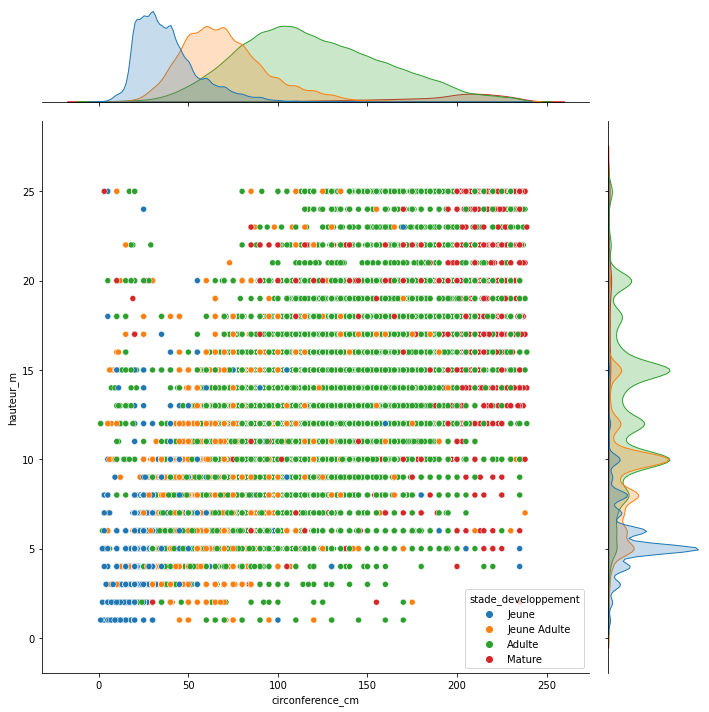

In [62]:
# Let's remove empty values
clean_data_dropna = clean_data.dropna(subset=['circonference_cm', 'hauteur_m', 'stade_developpement'])

sns.jointplot(data=clean_data_dropna,
    x="circonference_cm", 
    y="hauteur_m", 
    hue="stade_developpement",
    hue_order=['Jeune', 'Jeune Adulte', 'Adulte', 'Mature'],
    height=10,
);


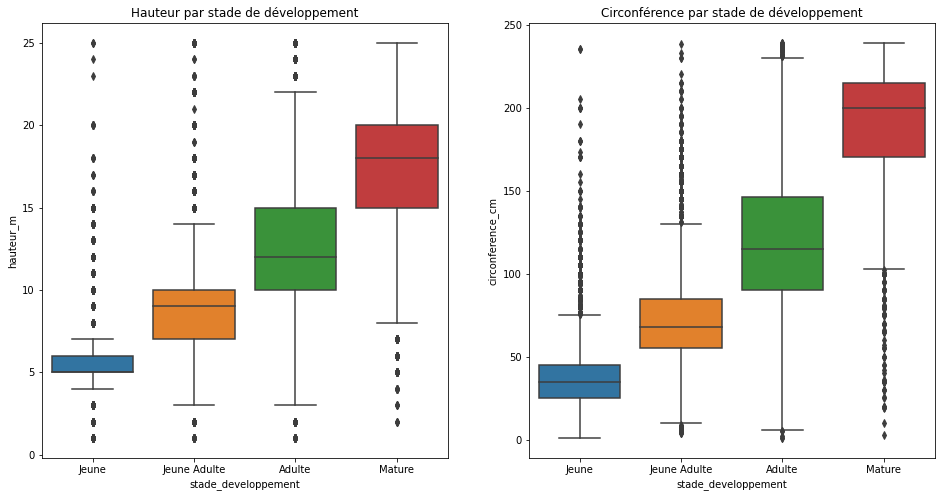

In [63]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16,8))
ax1.set_title("Hauteur par stade de développement")
ax2.set_title("Circonférence par stade de développement")

sns.boxplot(data=clean_data_dropna,
    x="stade_developpement", 
    y="hauteur_m",
    order=['Jeune', 'Jeune Adulte', 'Adulte', 'Mature'],
    ax=ax1,
)

sns.boxplot(data=clean_data_dropna,
    x="stade_developpement", 
    y="circonference_cm",
    order=['Jeune', 'Jeune Adulte', 'Adulte', 'Mature'],
    ax=ax2,
)


In [64]:

fig = px.scatter(clean_data_dropna,
    x='circonference_cm', y='hauteur_m',
    marginal_x="box", marginal_y="box",
    color="stade_developpement"
)
fig.show()


In [59]:

# Next remove outliers : top and bottom 1%
for col in ['circonference_cm', 'hauteur_m']:
    q1 = clean_data[col].quantile(0.25)
    q3 = clean_data[col].quantile(0.75)
    iqr = q3-q1
    min = q1-1.5*iqr
    max = q3+1.5*iqr
    clean_data = clean_data.loc[ 
        ( min < clean_data[col] ) & ( clean_data[col] < max ) 
    ]

print(data.shape)
print(clean_data.shape)

fig = px.scatter(clean_data,
    x='circonference_cm', y='hauteur_m',
    marginal_x="box", marginal_y="box",
    color="stade_developpement"
)
fig.show()

fig = px.scatter(clean_data,
    x='circonference_cm', y='hauteur_m',
    # facet_col="stade_developpement",
    # facet_row="libelle_francais",
    color="stade_developpement",
    # trendline="ols",
    width=1000,
    height=1000,
)
fig.show()


KeyError: ignored

In [ ]:
"""
sns.jointplot(
    data=clean_data, x="geo_point_2d_b", y="geo_point_2d_a", hue="arrondissement",
)

sns.jointplot(
    data=data, x="circonference_cm", y="hauteur_m", hue="stade_developpement",
)
"""

In [ ]:
"""
fig = px.scatter(
    clean_data, 
    x="geo_point_2d_b", y="geo_point_2d_a", color="arrondissement",
)
fig.show()
"""